# Image Analysis

In [1]:
import os
import sys
import torch
import random
import tifffile
import numpy as np
import matplotlib.pyplot as plt


# Get the parent directory (project root) and add it to sys.path
root_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if root_dir not in sys.path:
    sys.path.append(root_dir)


from utils.utils import normalize_image, standardize_per_image, unstandardize_tensor, compute_psnr

In [2]:
def print_statistics(name, img):
    print(f"\n--- Statistics for {name} ---")
    print(f"Shape: {img.shape}")
    print(f"Min: {img.min():.4f}")
    print(f"Max: {img.max():.4f}")
    print(f"Mean: {img.mean():.4f}")
    print(f"Std: {img.std():.4f}")

In [3]:
def plot_set(images_dict, scene_name, title_prefix):
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    for ax, (label, img) in zip(axs, images_dict.items()):
        ax.imshow(np.clip(img, 0, 1) if "standard" not in title_prefix else np.clip(img, -2, 2))
        ax.set_title(label, fontsize=9)
        ax.axis("off")
    plt.suptitle(f"{scene_name} - {title_prefix}", fontsize=14)
    plt.tight_layout()
    plt.show()

In [4]:
def process_and_print_stats(images_dict, clean_img, scene_name, mode):
    print(f"\n{scene_name.upper()} - {mode.upper()}")
    for label, img in images_dict.items():
        print_statistics(label, img)
        print(type(clean_img), type(img))
        if label != "4500 spp (clean)" and mode != "original":
            psnr = compute_psnr(img, clean_img)
            print(f"PSNR w.r.t clean: {psnr:.2f} dB")

In [5]:
def process_scene(folder_path):
    scene_name = os.path.basename(folder_path)
    files = os.listdir(folder_path)

    # Get file paths
    path_4500 = next((f for f in files if "spp4500" in f), None)
    path_32   = next((f for f in files if "spp32.tiff" in f and "1x32" not in f), None)
    path_1x32 = next((f for f in files if "spp1x32" in f), None)

    if not all([path_4500, path_32, path_1x32]):
        print(f"Missing files in {scene_name}, skipping...")
        return

    # Load images
    img_clean = tifffile.imread(os.path.join(folder_path, path_4500)).astype(np.float32)
    img_noisy = tifffile.imread(os.path.join(folder_path, path_32)).astype(np.float32)
    img_1spp_stack = tifffile.imread(os.path.join(folder_path, path_1x32)).astype(np.float32)  # (N, H, W, C)

    # Select random sample and compute mean
    random_sample = img_1spp_stack[random.randint(0, img_1spp_stack.shape[0] - 1)]
    mean_1spp = np.mean(img_1spp_stack, axis=0)

    images = {
        "1spp sample": random_sample,
        "mean 1spp": mean_1spp,
        "32 spp": img_noisy,
        "4500 spp (clean)": img_clean,
    }

    # ORIGINAL
    process_and_print_stats(images, img_clean, scene_name, "original")

    # NORMALIZED
    norm_images = {k: normalize_image(v.copy()) for k, v in images.items()}
    process_and_print_stats(norm_images, norm_images["4500 spp (clean)"], scene_name, "normalized")

    # STANDARDIZED
    std_images = {
        k: standardize_per_image(torch.from_numpy(v.copy()).permute(2, 0, 1).unsqueeze(0))[0]  # take only standardized tensor
            .squeeze(0).permute(1, 2, 0).numpy()
        for k, v in images.items()
    }
    process_and_print_stats(std_images, std_images["4500 spp (clean)"], scene_name, "standardized")

    plot_set(images, scene_name, "Original")
    plot_set(norm_images, scene_name, "Normalized")
    plot_set(std_images, scene_name, "Standardized")

In [6]:
def process_all_scenes(root_dir="output"):
    for folder in os.listdir(root_dir):
        folder_path = os.path.join(root_dir, folder)
        if os.path.isdir(folder_path):
            process_scene(folder_path)


BEDROOM - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 45.9288
Mean: 0.8264
Std: 3.2925
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 33.3325
Mean: 0.8334
Std: 2.0290
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 16.4919
Mean: 0.8335
Std: 2.0225
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 16.4648
Mean: 0.8343
Std: 1.9741
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

BEDROOM - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0180
Std: 0.0717
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 19.80 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0250
Std: 0.0610
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.

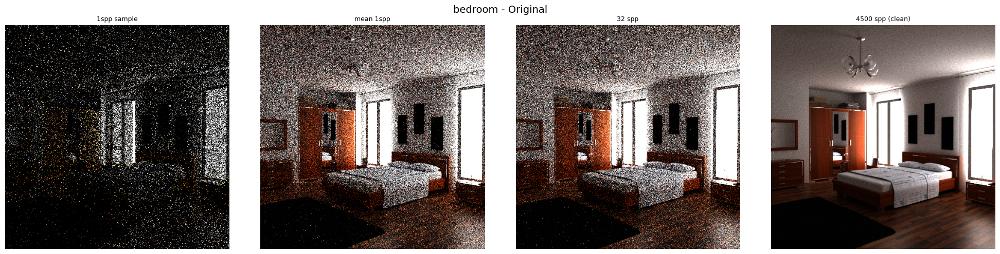

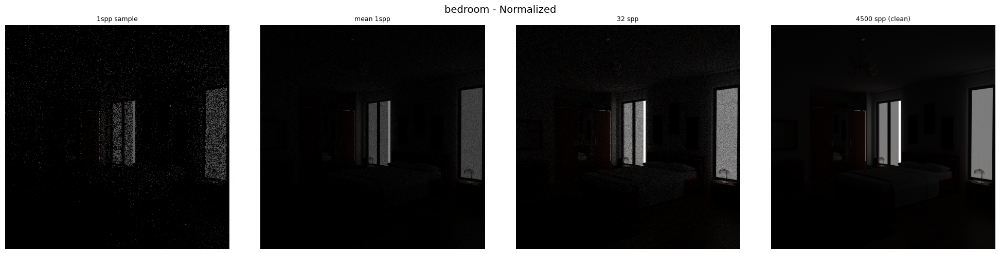

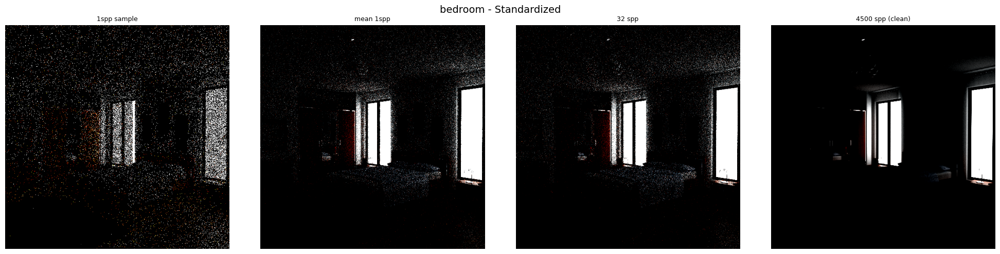


LIVING-ROOM - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 107.5058
Mean: 1.4979
Std: 7.4233
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 89.4375
Mean: 1.4985
Std: 7.2093
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 89.4375
Mean: 1.4979
Std: 7.2069
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 89.4375
Mean: 1.4983
Std: 7.2023
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

LIVING-ROOM - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0232
Std: 0.1007
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 30.39 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0248
Std: 0.1042
<class 'numpy.ndarray'> <class 'numpy.ndarray'

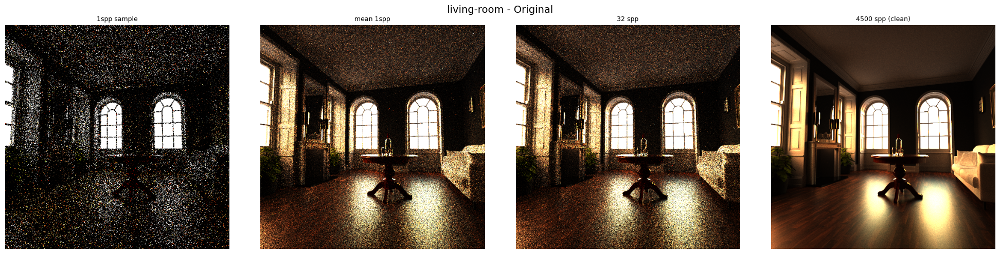

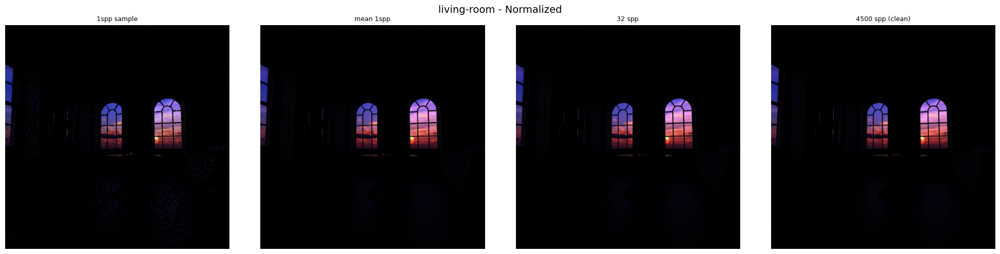

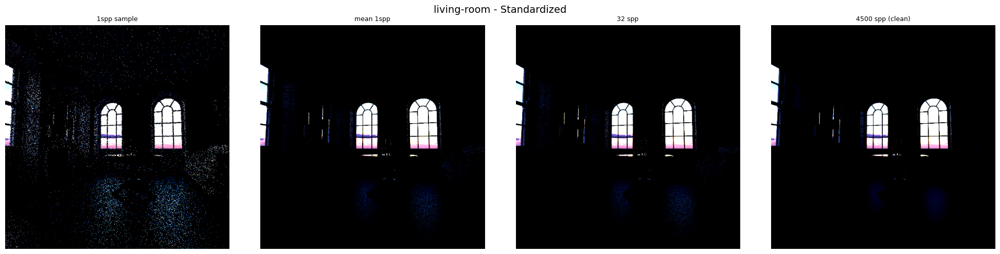


HOUSE-ABOVE - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 7.0283
Mean: 0.1601
Std: 0.2623
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 4.3939
Mean: 0.1605
Std: 0.1823
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 2.2395
Mean: 0.1605
Std: 0.1822
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0004
Max: 2.1321
Mean: 0.1605
Std: 0.1792
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

HOUSE-ABOVE - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0298
Std: 0.0490
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 19.86 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0719
Std: 0.0871
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSN

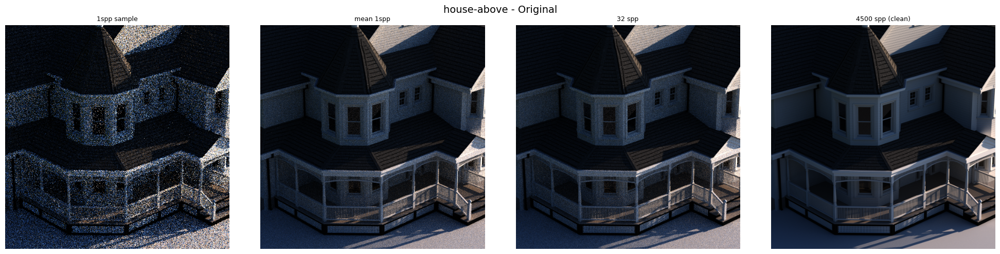

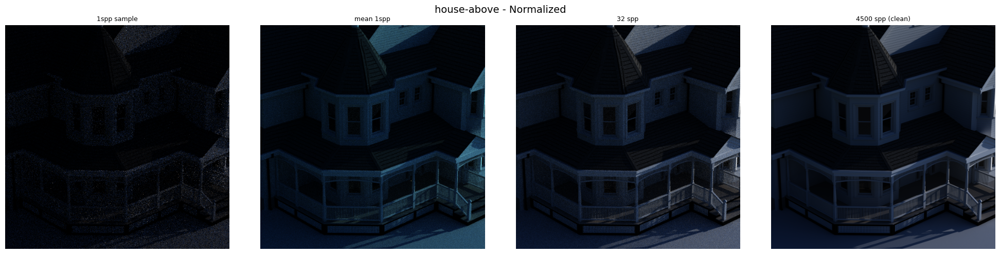

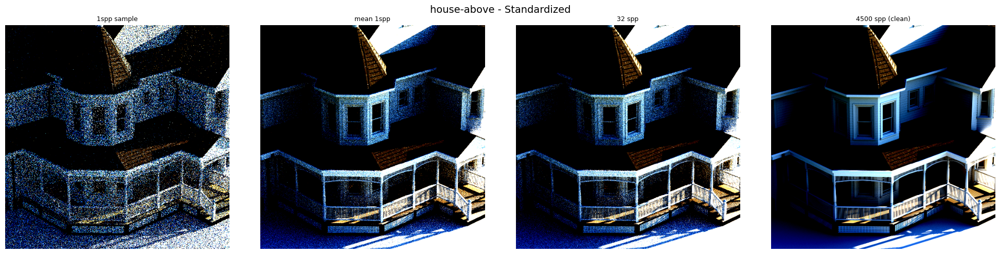


VEACH-AJAR - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1253.6896
Mean: 0.9906
Std: 8.5141
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 102.1083
Mean: 0.9778
Std: 1.9800
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 57.5667
Mean: 0.9521
Std: 1.9141
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0007
Max: 13.2398
Mean: 0.9503
Std: 1.2843
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

VEACH-AJAR - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0009
Std: 0.0081
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 18.25 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0154
Std: 0.0320
<class 'numpy.ndarray'> <class 'numpy.ndarray'

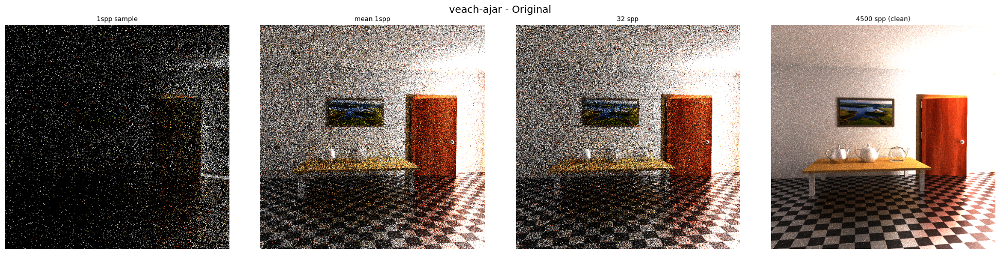

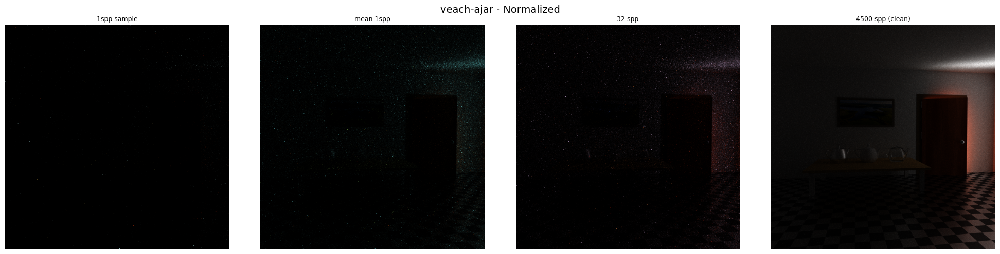

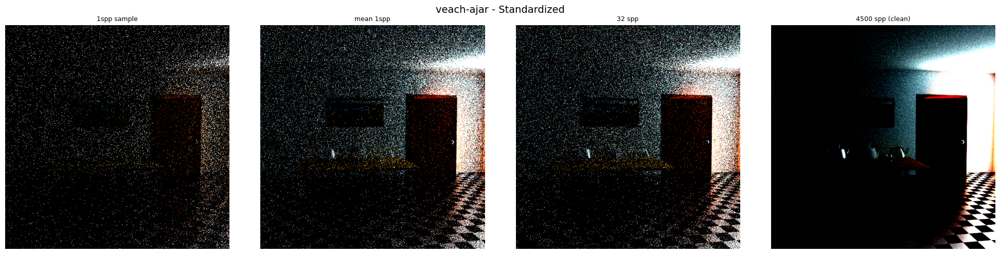


BATHROOM2 - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 342.2141
Mean: 4.6698
Std: 19.6229
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 125.0000
Mean: 4.6753
Std: 19.4429
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 125.0000
Mean: 4.6728
Std: 19.4419
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0007
Max: 125.0000
Mean: 4.6741
Std: 19.4344
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

BATHROOM2 - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0250
Std: 0.1058
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 20.46 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0467
Std: 0.1903
<class 'numpy.ndarray'> <class 'numpy.ndarr

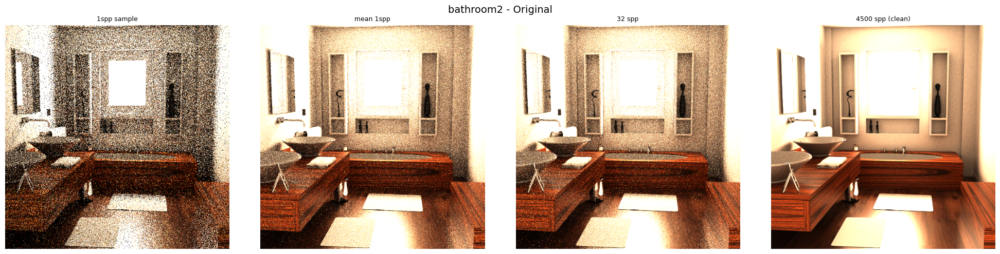

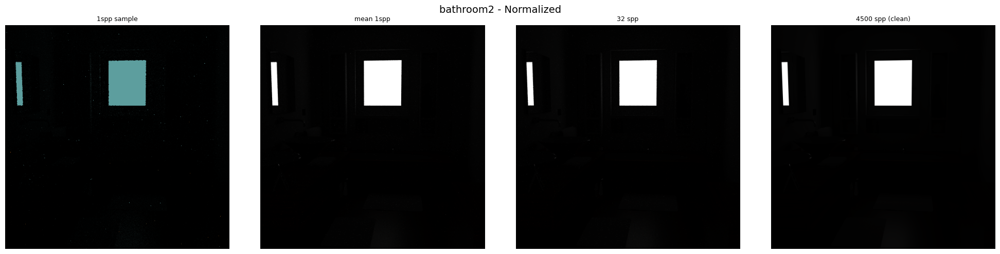

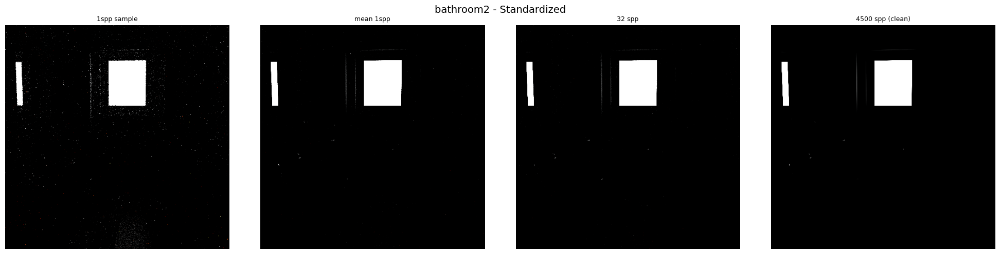


CLASSROOM - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 193.6735
Mean: 0.1948
Std: 1.1107
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 25.4712
Mean: 0.1988
Std: 0.5224
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 28.1558
Mean: 0.1991
Std: 0.5292
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 23.0561
Mean: 0.1990
Std: 0.4726
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

CLASSROOM - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0013
Std: 0.0070
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 31.83 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0099
Std: 0.0252
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PS

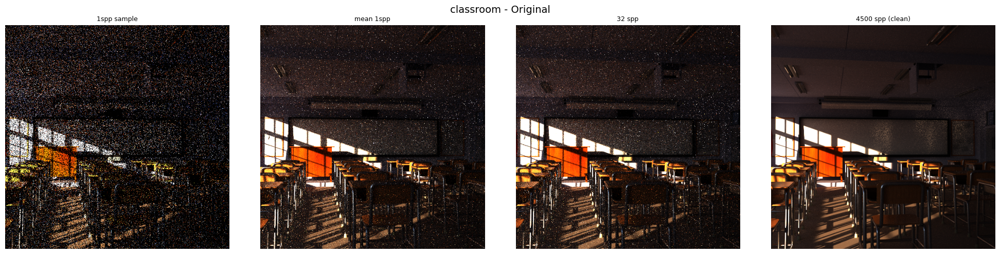

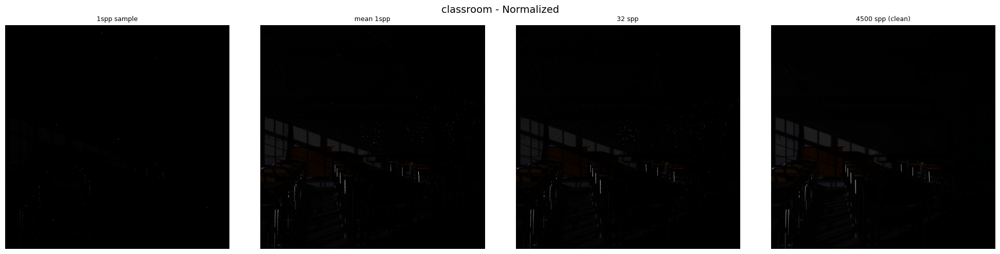

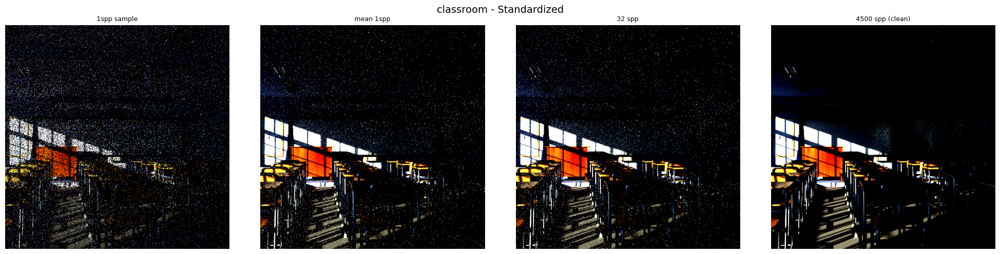


HOUSE - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 5.9130
Mean: 0.1641
Std: 0.2542
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.8644
Mean: 0.1642
Std: 0.1491
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.9353
Mean: 0.1640
Std: 0.1490
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 9.9882
Mean: 0.1641
Std: 0.1462
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

HOUSE - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0342
Std: 0.0535
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 26.03 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.1121
Std: 0.1064
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clea

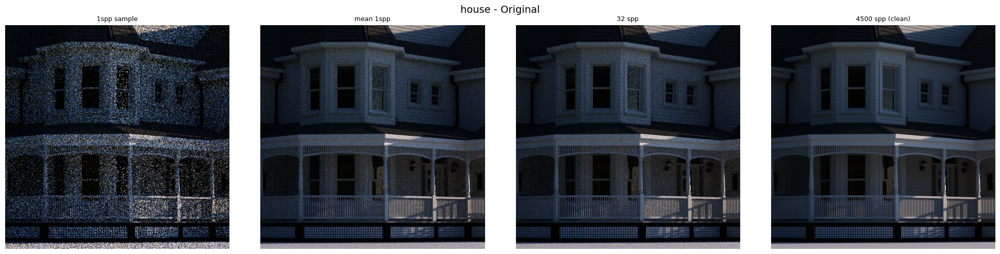

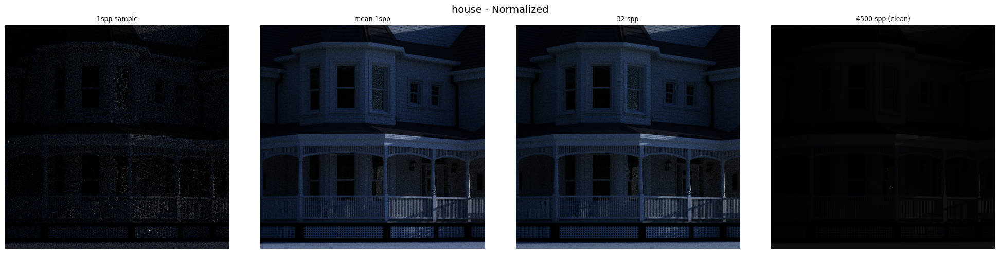

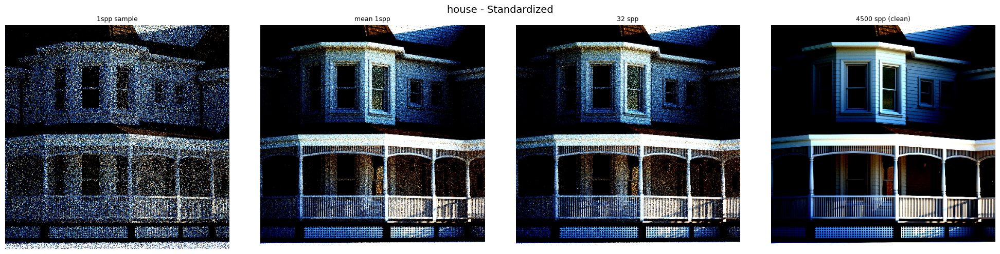


LIVING-ROOM-2 - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 26.6971
Mean: 0.7674
Std: 2.8767
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 17.7770
Mean: 0.7661
Std: 2.7364
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 17.7770
Mean: 0.7664
Std: 2.7370
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0001
Max: 17.7770
Mean: 0.7665
Std: 2.7329
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

LIVING-ROOM-2 - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0287
Std: 0.1078
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 23.99 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0431
Std: 0.1539
<class 'numpy.ndarray'> <class 'numpy.ndarr

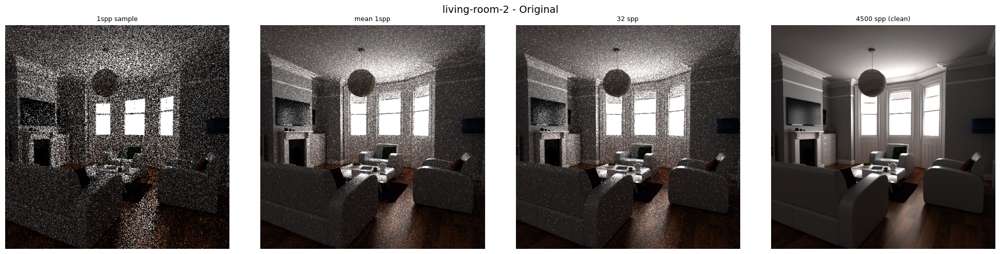

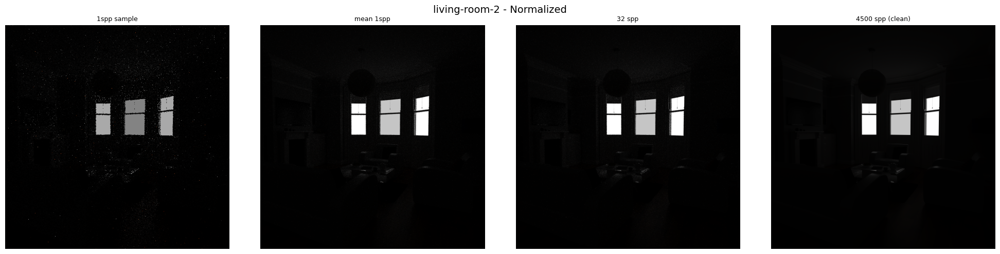

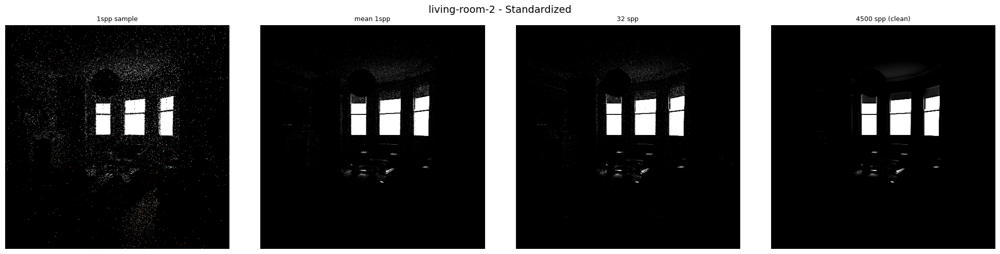


STAIRCASE2 - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 62.0333
Mean: 0.4866
Std: 0.9878
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 6.4218
Mean: 0.4876
Std: 0.5953
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 4.5786
Mean: 0.4880
Std: 0.5955
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0009
Max: 4.5750
Mean: 0.4880
Std: 0.5784
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

STAIRCASE2 - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0111
Std: 0.0209
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 13.89 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.1086
Std: 0.1181
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR

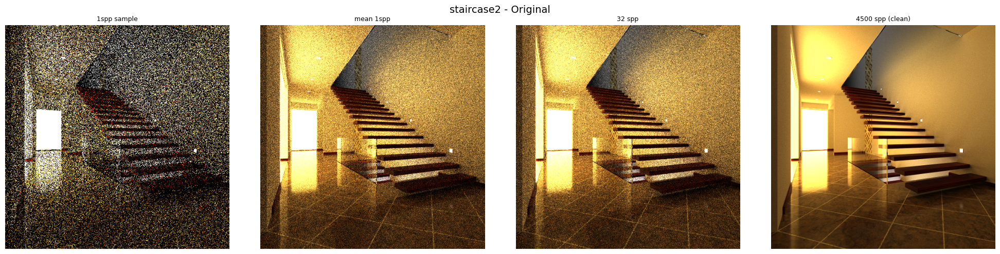

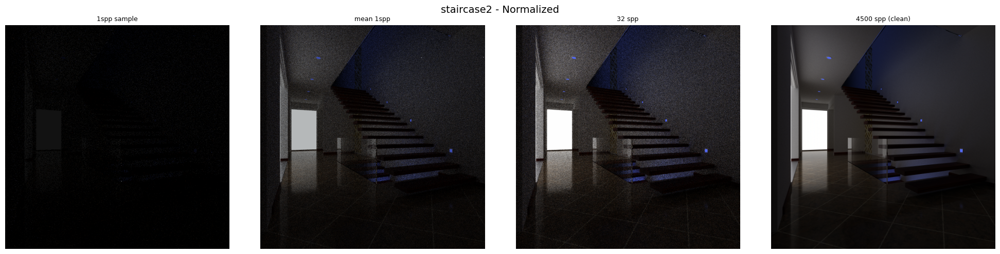

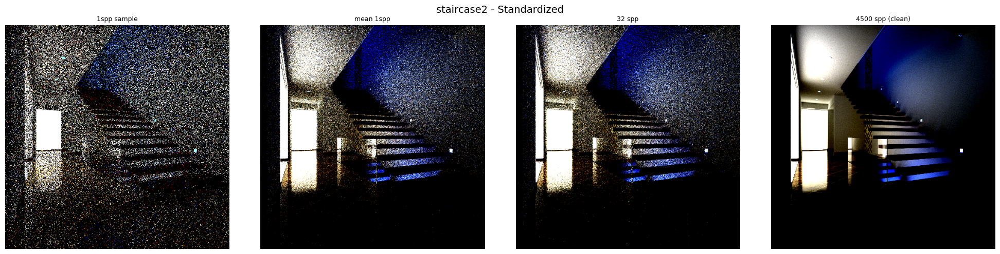


KITCHEN - ORIGINAL

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 44.7215
Mean: 0.9209
Std: 3.3258
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 16.0320
Mean: 0.9214
Std: 3.0660
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 32 spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 16.0320
Mean: 0.9212
Std: 3.0649
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

--- Statistics for 4500 spp (clean) ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 16.0320
Mean: 0.9214
Std: 3.0573
<class 'numpy.ndarray'> <class 'numpy.ndarray'>

KITCHEN - NORMALIZED

--- Statistics for 1spp sample ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0206
Std: 0.0744
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.r.t clean: 17.65 dB

--- Statistics for mean 1spp ---
Shape: (512, 512, 3)
Min: 0.0000
Max: 1.0000
Mean: 0.0575
Std: 0.1912
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
PSNR w.

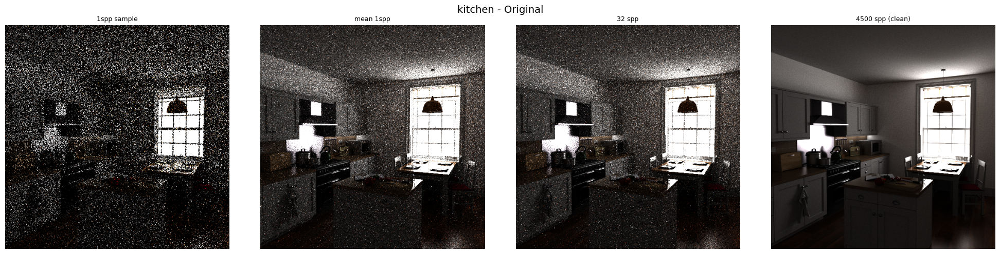

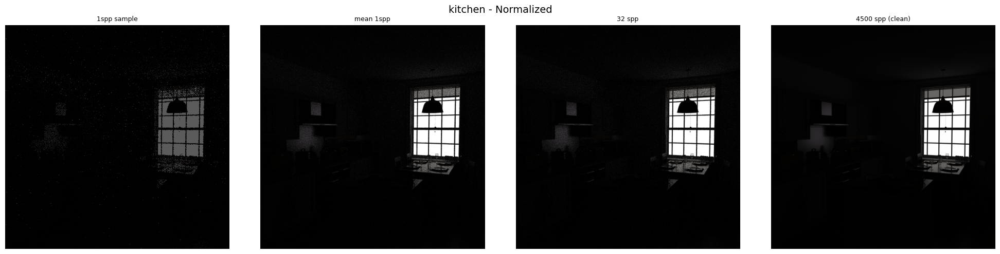

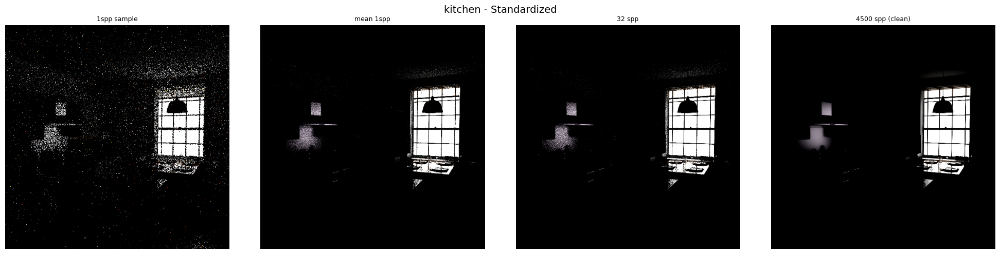

In [7]:
process_all_scenes("../output")

In [8]:
def load_all_images(folder_path):
    """
    Loads and averages images from a folder. Supports 3D (H, W, C) and 4D (N, H, W, C) TIFFs.

    Returns:
        torch.Tensor: shape (N, C, H, W)
    """
    images = []
    for root, _, files in os.walk(folder_path):
        for f in sorted(files):
            if f.endswith('.tiff') or f.endswith('.tif'):
                path = os.path.join(root, f)
                img = tifffile.imread(path).astype(np.float32)  # (H, W, C) or (N, H, W, C)

                if img.ndim == 4:
                    img = img.mean(axis=0)  # average over N samples → (H, W, C)
                elif img.ndim != 3:
                    raise ValueError(f"Unexpected image shape {img.shape} for {f}")

                img_tensor = torch.from_numpy(img).permute(2, 0, 1)  # to (C, H, W)
                images.append(img_tensor)

    return torch.stack(images)  # (N, C, H, W)

In [9]:
def process_folder_with_per_image_standardization(root_folder):
    all_standardized = []
    all_means = []
    all_stds = []
    scene_names = []

    for scene_name in os.listdir(root_folder):
        scene_path = os.path.join(root_folder, scene_name)
        if not os.path.isdir(scene_path):
            continue

        # Load all tiff images from this scene
        images = load_all_images(scene_path)  # returns list of NumPy arrays
        if len(images) == 0:
            continue

        scene_standardized = []
        scene_means = []
        scene_stds = []

        for img in images:
            if isinstance(img, np.ndarray):
                assert img.ndim == 3 and img.shape[2] == 3, f"Unexpected shape: {img.shape}"
                tensor = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float()  # [1, 3, H, W]
            elif isinstance(img, torch.Tensor):
                assert img.ndim == 3 and img.shape[0] == 3, f"Unexpected tensor shape: {img.shape}"
                tensor = img.unsqueeze(0).float()  # already [3, H, W] -> [1, 3, H, W]
            else:
                raise TypeError(f"Unsupported image type: {type(img)}")

            standardized, mean, std = standardize_per_image(tensor)

            # Convert back to NumPy for consistency or visualization
            standardized_np = standardized.squeeze(0).permute(1, 2, 0).numpy()

            scene_standardized.append(standardized_np)
            scene_means.append(mean.squeeze())  # Squeeze mean/std to [3]
            scene_stds.append(std.squeeze())

        all_standardized.extend(scene_standardized)
        all_means.extend(scene_means)
        all_stds.extend(scene_stds)
        scene_names.extend([scene_name] * len(images))

    return all_standardized, all_means, all_stds, scene_names

In [10]:
folder = '../output'
standardized_images, image_means, image_stds, scene_names= process_folder_with_per_image_standardization(folder)
print(f"Total Standardised Images: {len(standardized_images)}")

Total Standardised Images: 30


In [11]:
def plot_standardized_vs_unstandardized(standardized_images, means, stds, scene_names, indices=None, max_plots=10):
    """
    Plots standardized images next to their unstandardized versions.

    Args:
        standardized_images (list of np.ndarray): List of standardized images (C, W, H).
        means (list of torch.Tensor): List of means per image (C, 1, 1).
        stds (list of torch.Tensor): List of stds per image (C, 1, 1).
        scene_names (list of str): Scene name for each image.
        indices (list of int): Indices of images to plot. If None, selects first N.
        max_plots (int): Max number of images to plot if indices not specified.
    """
    if indices is None:
        indices = list(range(min(len(standardized_images), max_plots)))

    for idx in indices:
        std_img = torch.from_numpy(standardized_images[idx])  # (C, H, W)
        mean = means[idx]
        std = stds[idx]

        # UNSTANDARDISE
        unstd_tensor = unstandardize_tensor(std_img, mean, std)

        print(scene_names[idx].upper())
        # PLOT
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))

        # Standardized image
        axs[0].imshow(np.clip(std_img, -2, 2))  # already in HWC
        axs[0].set_title("Standardized", fontsize=10)
        axs[0].axis("off")

        # Unstandardized image
        axs[1].imshow(np.clip(unstd_tensor.numpy(), 0, 1))
        axs[1].set_title("Unstandardized", fontsize=10)
        axs[1].axis("off")

        plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.43647337..2.0].


BEDROOM


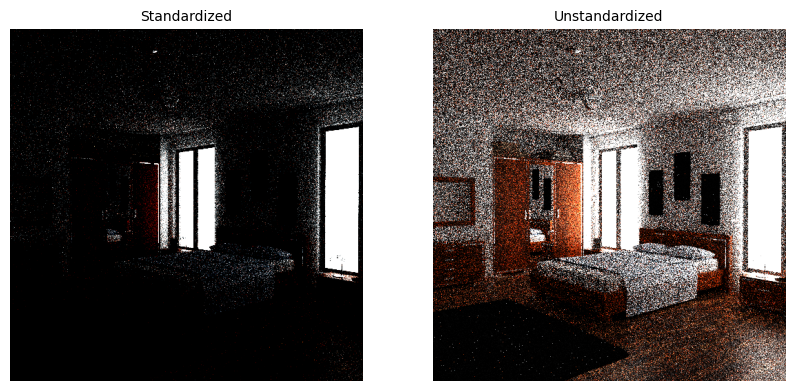

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2623064..2.0].


LIVING-ROOM


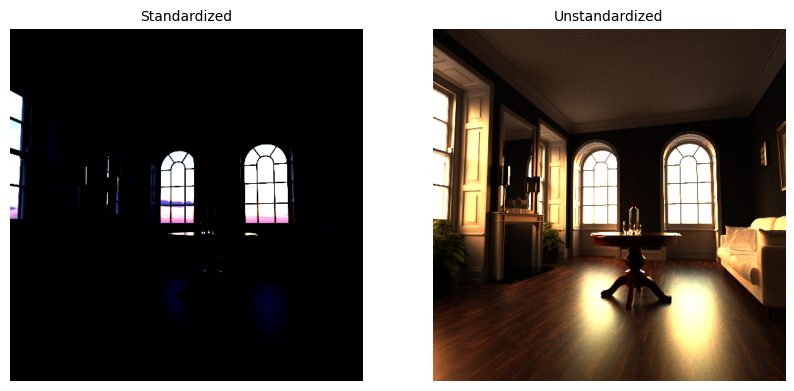

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5306874..2.0].


VEACH-AJAR


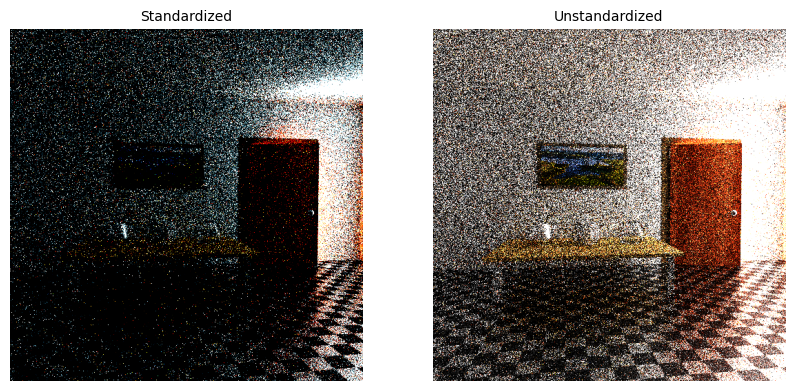

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4060645..2.0].


CLASSROOM


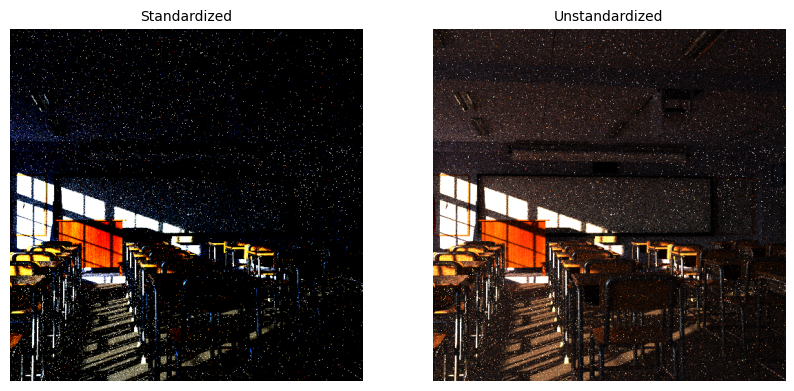

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2860092..2.0].


HOUSE


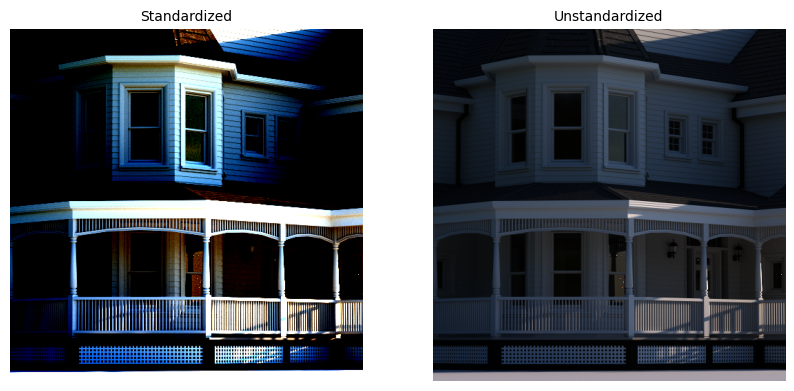

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9629388..2.0].


STAIRCASE2


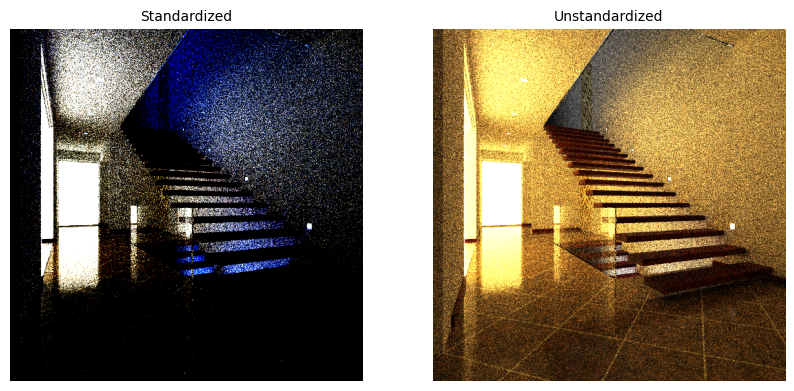

In [12]:
plot_standardized_vs_unstandardized(
    standardized_images,
    image_means,
    image_stds,
    scene_names,
    indices=[0, 5, 10, 15, 20, 25]
)